## Portfolio Assignment week 03

This week's focus is on anomaly detection. As part of the portfolio assignment, you are required to make a contribution using anomaly detection algorithm(s). There are several options for your contribution, so you can choose the one that aligns with your learning style or interests the most

## Anomaly Detection

Anomaly detection in machine learning refers to the process of identifying patterns or instances in a dataset that deviate significantly from the norm or expected behavior. Anomalies, also known as outliers, are data points that are rare, unusual, or don't conform to the typical patterns observed in the majority of the data. Anomaly detection algorithms aim to automatically detect these anomalies. Anomaly detection in machine learning has various applications across domains, including predictive maintenance, and healthcare monitoring. By automatically identifying anomalies, these algorithms help in detecting potential risks. 


## Anomaly Detection Assignment

Study the notebook [Study_Case_Anomoly_Detection](https://github.com/fenna/BFVM23DATASCNC5/blob/main/Study_Cases/Study_Case_Anomaly_Detection.ipynb):


Unsupervised anomaly detection algorithms can detect data that does not belong to normal data patterns. In general, it looks for isolated samples, samples that are in low-density regions. Anomaly detection algorithms can be divided into several approaches such as:

-	Density based 
-	Distance based 
-   Kernel based
-	Statistical approaches
-	Tree-based methods 

In this notebook we test a few of these algorithms. The Local Outlier Factor, robust covariance, One Class Support Vector Machine, and the Isolation Forest.

**Local Outlier Factor** LOF compares the density of any given data point to the density of its neighbors. Since outliers come from low-density areas, the ratio will be higher for anomalous data points. As a rule of thumb, a normal data point has a LOF between 1 and 1.5 whereas anomalous observations will have much higher LOF. The higher the LOF the more likely it is an outlier (2).
Density-based methods identify anomalies based on the local density of data points. Anomalies are detected as points that have significantly lower density compared to their neighboring points. Another example next to LOF is  DBSCAN.

**Distance-based** methods determine anomalies by measuring the distance or dissimilarity of data points to their neighboring points. Points that are significantly distant or dissimilar from others are considered anomalies. Examples include k-nearest neighbors (k-NN), distance-based outlier detection (e.g., using Mahalanobis distance or Euclidean distance), and angle-based outlier detection. 

The **robust covariance** method is a **gaussian elipse-based method**. If it is outside the gaussian curve, or on the edges it might be an outlier. It is based on the Mahalanobis distance which assesses how many standard deviations σ away xᵢ is from μ. An extreme observation has a large distance from the center of a distribution. An envelope around the data set can be constructed by choosing a critical value of the Mahalanobis distance. Points outside this envelope are considered anomalies/outliers. (1)

**One Class Support Vector Machine** is cluster method based on the Support Vector Machine algorithm. Instead of separating classes into clusters, it separates one class from the origin. The points outside the boundary line are classified as outliers. It uses kernels. The default kernel is ‘rbf’ since most of the time the boundary is not linear. (3)

**Isolation Forest is a tree-based** method. The Isolation Forest algorithm does not explicitly consider density or neighborhood relationships between data points. Instead, it uses the idea that anomalies can be identified more quickly and easily in the tree structure compared to normal data points. Anomalies are expected to have shorter paths in the tree, as they require fewer splits to be isolated. It uses partitioning to make isolated trees, with the goal that each point is isolated. The more partitioning is needed, the more chance a data point is a regular point. An outlier is much easier to isolate than a regular point.  (4)



[1] Nascimento et all. "A cluster-based algorithm for anomaly detection in time series using Mahalanobis distance." Proceedings on the International Conference on Artificial Intelligence (ICAI). The Steering Committee of The World Congress in Computer Science, Computer Engineering and Applied Computing (WorldComp), 2015. 

[2] Alghushairy, Omar, et al. "A review of local outlier factor algorithms for outlier detection in big data streams." Big Data and Cognitive Computing 5.1 (2020): 1.

[3] Schölkopf, Bernhard, et al. "Support vector method for novelty detection." Advances in neural information processing systems 12 (1999).

[4] Liu, Fei Tony, Kai Ming Ting, and Zhi-Hua Zhou. "Isolation-based anomaly detection." ACM Transactions on Knowledge Discovery from Data (TKDD) 6.1 (2012): 1-39.


# Hypothesis

Anomaly detection techniques are commonly employed in predictive maintenance strategies to identify abnormal patterns or behaviors in machine data that may indicate impending failures.

By monitoring various sensor readings, operational parameters, or other relevant data from machines, anomaly detection algorithms can learn the normal behavior or expected patterns of the machines during their normal operation. When a deviation from the normal behavior is detected, it may indicate a potential failure or malfunction. The hypothesis is that the sensor readings of a pump will generate not normal values in case of an (upcoming) failure, and these can be determined with anomaly detection. Several algorithms will be used to evaluate the hypothesis 

datasource: https://www.kaggle.com/datasets/nphantawee/pump-sensor-data



Choose at least 1 out of the listed assignments below

- Analyze the end result plot to evaluate the algorithm's performance. Look for anomalies identified by the algorithm and compare them to known anomalies or instances of abnormal behavior in the data. Assess whether the algorithm successfully captures these anomalies and if it shows promising results in detecting abnormal patterns. Based on the plot analysis, provide argumentation for the validity of the anomaly detection algorithm hypothesis (see above). Discuss how the algorithm effectively captures anomalies in the time series data and why it is a suitable approach for the use case. Support your argument with references to relevant literature that discuss the effectiveness of the chosen algorithm or similar algorithms in detecting anomalies in time series data.
- To improve data quality for anomaly detection in time series data, we can focus on removing outliers due to sensor reading errors while preserving anomalies. Additionally, performing resampling or aggregation can help reduce noise and highlight higher-level patterns relevant for anomaly detection. Find common steps to improve data quality for this particular use and implement those. Evaluate the performance of the algorithms compare to the original notebook.
- #### **Try another algorithm that has not been tested in the notebook. Provide argumentation for the validity of the anomaly detection algorithm you choose.**  
- Try to find the best configuration for one of the tested algorithms
- Try anomaly detection on a different dataset without timeseries data. Intrepret the results

Do not forget to reference sources!

--------


## Solution
#### Author: Karina Diaz


In [2]:
# Libraries
import yaml
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import hvplot.pandas 

from sklearn.preprocessing import StandardScaler
from sklearn import svm
from sklearn.covariance import EllipticEnvelope
from sklearn.ensemble import IsolationForest
from sklearn.neighbors import LocalOutlierFactor
from sklearn.mixture import BayesianGaussianMixture


In [3]:
# Defining a function to get the config file
def get_config():
    '''Setting the config file'''
    with open("config_DS3.yaml", 'r') as stream:
        config = yaml.safe_load(stream)
    return config

config = get_config()
data_path = (config['sensor'])
data_path

# Creating a data frame with the data
data_df = pd.read_csv(data_path)
data_df.head(3)


,Unnamed: 0,timestamp,sensor_00,sensor_01,sensor_02,sensor_03,sensor_04,sensor_05,sensor_06,sensor_07,...,sensor_43,sensor_44,sensor_45,sensor_46,sensor_47,sensor_48,sensor_49,sensor_50,sensor_51,machine_status
0,0,2018-04-01 00:00:00,2.465394,47.09201,53.2118,46.31076,634.3750,76.45975,13.41146,16.13136,...,41.92708,39.641200,65.68287,50.92593,38.194440,157.9861,67.70834,243.0556,201.3889,NORMAL
1,1,2018-04-01 00:01:00,2.465394,47.09201,53.2118,46.31076,634.3750,76.45975,13.41146,16.13136,...,41.92708,39.641200,65.68287,50.92593,38.194440,157.9861,67.70834,243.0556,201.3889,NORMAL
2,2,2018-04-01 00:02:00,2.444734,47.35243,53.2118,46.39757,638.8889,73.54598,13.32465,16.03733,...,41.66666,39.351852,65.39352,51.21528,38.194443,155.9606,67.12963,241.3194,203.7037,NORMAL


### Inspectioning the data

##### Highlights:

* The data is compose of 55 columns and 220,320 rows. In the columns we can see `Unnamed`,`time stamp`, `sensor_n` and `machine_status`. The rows represent the different moments (time stamp) of the data. 
* The data types are correct, so I do not transform any column. 
* The last column `machine_status` idicates what is the state of the pump:
    * Normal: 205,836
    * Recovering: 14,477
    * Broken: 7
* There are missing values for several sensors, some of them have more missing values than others. I just deleted the ones with the highest % of missing values as the other can be imputed by using the mean of that column in particular.
* Some low quality columns are deleted because they do not provide enough information fot the analysis.

In [4]:
print('Data shape: ', data_df.shape)
print(data_df.info())

Data shape:  (220320, 55)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 220320 entries, 0 to 220319
Data columns (total 55 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   Unnamed: 0      220320 non-null  int64  
 1   timestamp       220320 non-null  object 
 2   sensor_00       210112 non-null  float64
 3   sensor_01       219951 non-null  float64
 4   sensor_02       220301 non-null  float64
 5   sensor_03       220301 non-null  float64
 6   sensor_04       220301 non-null  float64
 7   sensor_05       220301 non-null  float64
 8   sensor_06       215522 non-null  float64
 9   sensor_07       214869 non-null  float64
 10  sensor_08       215213 non-null  float64
 11  sensor_09       215725 non-null  float64
 12  sensor_10       220301 non-null  float64
 13  sensor_11       220301 non-null  float64
 14  sensor_12       220301 non-null  float64
 15  sensor_13       220301 non-null  float64
 16  sensor_14       220299 non-nul

In [5]:
# Checking how the data is divided
data_df.machine_status.value_counts()

NORMAL        205836
RECOVERING     14477
BROKEN             7
Name: machine_status, dtype: int64

#### Cleaning and filtering the data

In [6]:
# Cheking for missing values
missing = data_df.isnull().sum()
print('-> Missing data in:', missing[missing > 0].size, 'columns')
print('-'*50)
missing_porcen = missing.sort_values(ascending=False)/len(data_df)*100
# show the 5 values with the largest % of missing data
print('-> Columns with the largest % of missing data:')
print('Sensor     | % of missing data')
print(missing_porcen.head(5))

-> Missing data in: 52 columns
--------------------------------------------------
-> Columns with the largest % of missing data:
Sensor     | % of missing data
sensor_15    100.000000
sensor_50     34.956881
sensor_51      6.982117
sensor_00      4.633261
sensor_07      2.474129
dtype: float64


In [7]:
# Dropping non needed and low quality columns
# 'sensor_15' and 'sensor_50' have a lot of missing data values compared with 
# the other sensors
data_df.drop(['Unnamed: 0','sensor_15', 'sensor_50'], axis=1, inplace=True)

# Convert timestamp to datetime and set it as index
data_df['timestamp'] = pd.to_datetime(data_df['timestamp'])
data_df.set_index('timestamp', inplace=True)
data_df.head(3)

,sensor_00,sensor_01,sensor_02,sensor_03,sensor_04,sensor_05,sensor_06,sensor_07,sensor_08,sensor_09,...,sensor_42,sensor_43,sensor_44,sensor_45,sensor_46,sensor_47,sensor_48,sensor_49,sensor_51,machine_status
timestamp,,,,,,,,,,,,,,,,,,,,,
2018-04-01 00:00:00,2.465394,47.09201,53.2118,46.31076,634.3750,76.45975,13.41146,16.13136,15.56713,15.05353,...,31.770832,41.92708,39.641200,65.68287,50.92593,38.194440,157.9861,67.70834,201.3889,NORMAL
2018-04-01 00:01:00,2.465394,47.09201,53.2118,46.31076,634.3750,76.45975,13.41146,16.13136,15.56713,15.05353,...,31.770832,41.92708,39.641200,65.68287,50.92593,38.194440,157.9861,67.70834,201.3889,NORMAL
2018-04-01 00:02:00,2.444734,47.35243,53.2118,46.39757,638.8889,73.54598,13.32465,16.03733,15.61777,15.01013,...,31.770830,41.66666,39.351852,65.39352,51.21528,38.194443,155.9606,67.12963,203.7037,NORMAL


### Data exploration

In [8]:
# Create a box plot of the data
boxplot1 = data_df.hvplot.box(height=1000, width=500, invert=True,c='orange',
                        group_label='Pump Sensor', 
                        value_label='Sensor data through time',
                        title = 'Pumps sensor data through time')


In [9]:
boxplot1

:BoxWhisker   [Pump Sensor]   (Sensor data through time)

With these boxplots we have and idea of how the data looks like and how it is distributed. The data is spare in the different sensors.  

As we can see there are some outliers that are going to be detected and managed with the anomaly detection algorithms in the following steps.

In [10]:
# Divide the sensor data based on its machine status
broken_rows = data_df[data_df['machine_status']=='BROKEN']
recovery_rows = data_df[data_df['machine_status']=='RECOVERING']
normal_rows = data_df[data_df['machine_status']=='NORMAL']

def plot_sensor(sensor):
    '''Function to plot the a given sensor over time.
    normal (grey), recovery(yellow) and borken(red)'''
    plt.figure(figsize=(25,3))
    plt.plot(data_df[sensor], color='grey', label='Normal')
    plt.plot(recovery_rows[sensor], linestyle='none', marker='o', 
                    color='yellow', markersize=5, label='Recovering')
    plt.plot(broken_rows[sensor], linestyle='none', marker='X', 
                    color='red', markersize=14, label = 'Broken')
    plt.title(sensor)
    plt.legend()
    plt.show();

Plot some sensors to get an idea of how they look and where are the normal, recovering and broken states.

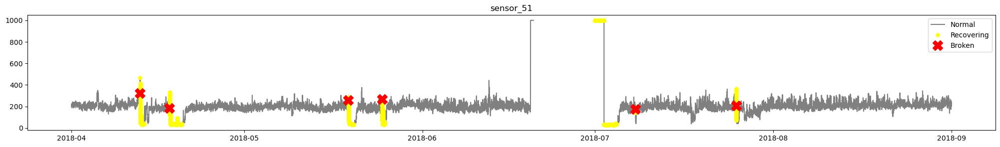

In [11]:
plot_sensor('sensor_51')

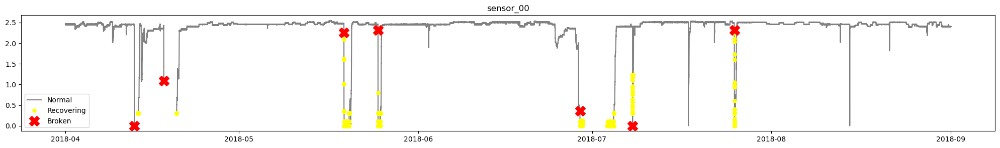

In [12]:
plot_sensor('sensor_00')

## Preprocess for machine learning
#### Imputation

In [13]:
# Use mean of the column to handle missing values and remove label in feature matrix X
m, n = data_df.shape
# Ignore machine status columns (last column in the dataframe)
X = data_df.iloc[:,:n-1] 
X = X.fillna(X.mean())
# Matrix with the data
X.shape

(220320, 50)

#### Scaling 

In [14]:
# Standardize features by removing the mean and scaling to unit variance.
scaler = StandardScaler()
# Fit to data, then transform it.
X = scaler.fit_transform(X)

## Testing algorithms

In [15]:
outliers_fraction = 1 - (len(normal_rows)/(len(data_df))) 

anomaly_algorithms = [
    ("Isolation Forest",IsolationForest(contamination=outliers_fraction,
                                        n_jobs = -1)),
    ("One-Class SVM", svm.OneClassSVM(nu=outliers_fraction)),
    ("Local Outlier Factor",LocalOutlierFactor(contamination=outliers_fraction,
                                               n_jobs = -1)),
    ("Robust covariance", EllipticEnvelope(contamination=outliers_fraction))]

# !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
# ## fit the models: Mind you this takes a lot of time (~22 min)!!!!!!!!
# !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
for name, algorithm in anomaly_algorithms:
    print(algorithm)

    if name == "Local Outlier Factor":
        y_pred = algorithm.fit_predict(X)
    else:
        y_pred = algorithm.fit(X).predict(X)
    
    data_df[f'{name}'] = y_pred
    print('-'*100)
    print(f'Number of anomalies detected')
    print(data_df[f'{name}'].value_counts())
    print('-'*100)

IsolationForest(contamination=0.06574074074074077, n_jobs=-1)
----------------------------------------------------------------------------------------------------
Number of anomalies detected
 1    205836
-1     14484
Name: Isolation Forest, dtype: int64
----------------------------------------------------------------------------------------------------
OneClassSVM(nu=0.06574074074074077)
----------------------------------------------------------------------------------------------------
Number of anomalies detected
 1    205831
-1     14489
Name: One-Class SVM, dtype: int64
----------------------------------------------------------------------------------------------------
LocalOutlierFactor(contamination=0.06574074074074077, n_jobs=-1)
----------------------------------------------------------------------------------------------------
Number of anomalies detected
 1    205836
-1     14484
Name: Local Outlier Factor, dtype: int64
-------------------------------------------------------

**(1)** represent the **inliers** or **normal instances**.  
**(-1)** represent the **outliers** or **anomalies**.  

*IsolationForest*, *OneClassSVM* and *EllipticEnvelope* find the same number of anomalies. *LocalOutlierFactor* does not find 5 anomalies that others algorithms do. 


In [16]:
# Get only the data where all the algorithms found an outlier
df_anomal = data_df.iloc[0:,-5:]
df_anomal = df_anomal.loc[(df_anomal['Isolation Forest'] == -1) &
              (df_anomal['One-Class SVM'] == -1) & 
              (df_anomal['Local Outlier Factor'] == -1) & 
              (df_anomal['Robust covariance'] == -1)]
df_anomal.head(5)


,machine_status,Isolation Forest,One-Class SVM,Local Outlier Factor,Robust covariance
timestamp,,,,,
2018-05-01 12:29:00,NORMAL,-1,-1,-1,-1
2018-05-01 15:52:00,NORMAL,-1,-1,-1,-1
2018-05-01 15:53:00,NORMAL,-1,-1,-1,-1
2018-05-01 15:54:00,NORMAL,-1,-1,-1,-1
2018-05-01 15:55:00,NORMAL,-1,-1,-1,-1


In [17]:
print(df_anomal.machine_status.value_counts())

NORMAL    183
Name: machine_status, dtype: int64


As we can see, the algorithms did not exactly predict all the anomalies. Here I presented an subset of data were *all* the algorithms applied detected an *anomaly*, but as we can see all the values were defined as NORMAL rather than BROKEN. That means that at least *183 values* are predicted incorrectly (*false positives*) by the algorithms applied.

The algorithms did predict anomalies that were anomalies, but the parameters need to be tuned in order to avoid false positives.  

To see this graphically down bellow I show two sensors plotted and the anomalities predicted by all the algorithms. 


In [18]:
def plot_sensor_anomalies(sensor, name):
    '''Function to plot a sensor and an algorithm over time. Normal (grey), 
    recovery(yellow) and borken(red), predicted anomaly (blue)'''

    anomaly_rows = data_df[data_df[f'{name}'] == -1]
    plt.figure(figsize=(25,3))
    plt.plot(data_df[sensor], color='grey', label='Normal')
    plt.plot(recovery_rows[sensor], linestyle='none', marker='o', 
                    color='yellow', markersize=5, label='Recovering')
    plt.plot(broken_rows[sensor], linestyle='none', marker='X', 
                    color='red', markersize=20, label='Broken')
    plt.plot(anomaly_rows[sensor], linestyle='none', marker='X', 
                    color='blue', markersize=4, label='Predicted anomaly',
                    alpha = 0.1)
    plt.title(sensor)
    plt.legend()
    plt.show();

Isolation Forest


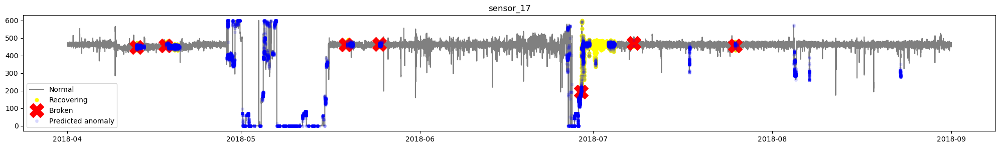

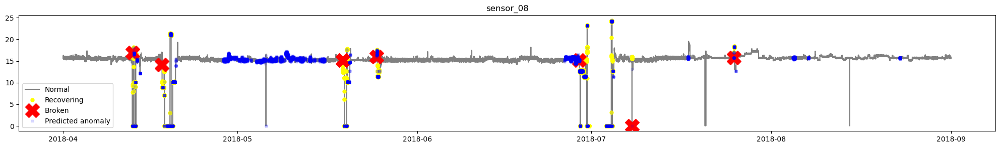

In [19]:
print('Isolation Forest')
plot_sensor_anomalies('sensor_17', 'Isolation Forest')
plot_sensor_anomalies('sensor_08', 'Isolation Forest')

One-Class SVM


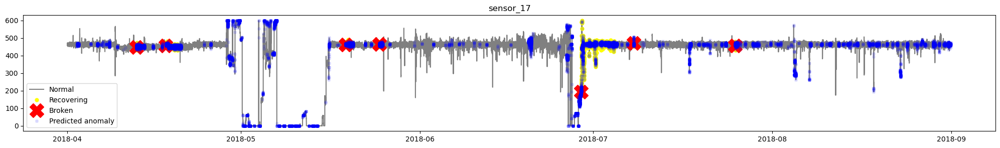

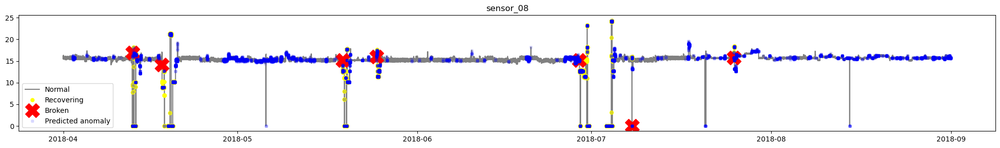

In [20]:
print("One-Class SVM")
plot_sensor_anomalies('sensor_17', "One-Class SVM")
plot_sensor_anomalies('sensor_08', "One-Class SVM")

Local Outlier Factor


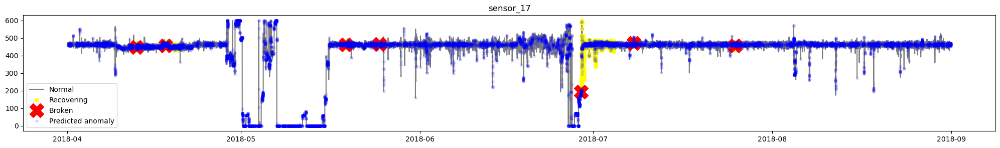

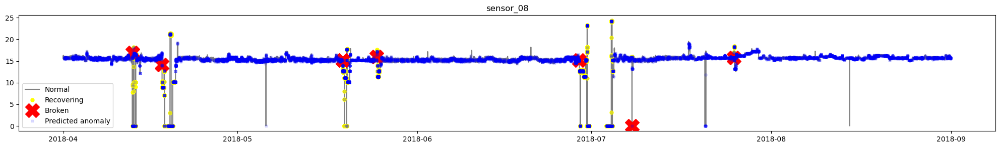

In [21]:
print("Local Outlier Factor")
plot_sensor_anomalies('sensor_17', "Local Outlier Factor")
plot_sensor_anomalies('sensor_08', "Local Outlier Factor")

Robust covariance


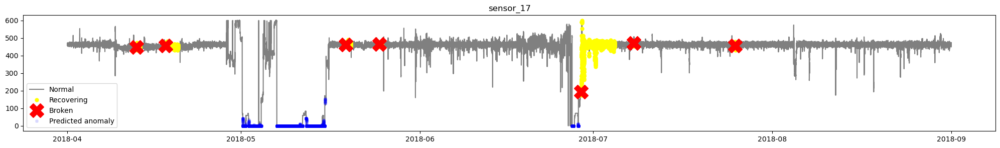

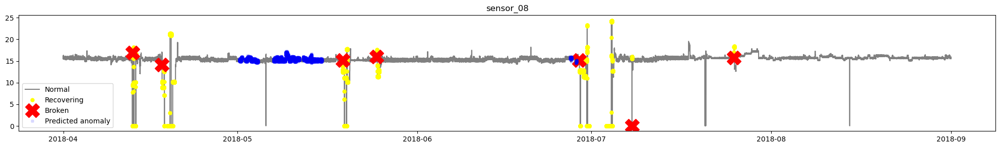

In [22]:
print("Robust covariance")
plot_sensor_anomalies('sensor_17', "Robust covariance")
plot_sensor_anomalies('sensor_08', "Robust covariance")

The models predict anomalies near the broken points but is not perfect.  
The "Local Outlier Factor" algorithm is the worst in between all of the ones tested. 
 
Extra information about this algorithms and when to use them:  

 - **Elliptic Envelope** is useful for outlier detection, particular to cleanup a dataset.  
 - **Isolation forest** is an efficient algorithm for outlier detection, especially in high-dimensional datasets.
 - **One-class SVM** is useful especially with high-dimensional datasets, but it does not scale to large datasets. Despite it works finding anomalies, is better suited for novelty detection.  

## Extra model: Implementing Bayesian Gaussian Mixture Model

Variational Bayesian estimation of a Gaussian mixture.

This model infers an approximate *posterior distribution* over the parameters of a *Gaussian mixture distribution*. BayesianGaussianMixture class which is capable of giving weights equal (or close) to zero to unnecessary clusters and **eliminate the unnecessary clusters automatically**. This is useful if we have previous knowledge about the data. So that the number of components **(n_com)** can be inferred. A good n_comp number needs to be **a value that you have good reason to believe is greater than the optimal number of clusters**

There is no contamination parameter in this case.  

I set the number of *`n_components` as 2*, because I expect **2 different clusters: anomalies and novelties**.

I set the *`tol` as 1e-2*, that is bigger than the default=1e-3. Because with the default value I was getting a warning that the algorithm did not converge. So I increased the convergence threshold, that is that I am allowing a 'bigger error'.

In [23]:
new_algorithm = BayesianGaussianMixture(n_components=2, 
                                        tol= 1e-2,
                                        random_state=42)

new_algorithm.fit(X)

print('Weights of every component')
np.round(new_algorithm.weights_,2)

Weights of every component


array([0.29, 0.71])

In [24]:
y_pred = new_algorithm.fit_predict(X)
data_df['Bayesian Gaussian Mixture'] = y_pred
print('-'*100)
print(f'Number of anomalies detected')
print(data_df['Bayesian Gaussian Mixture'].value_counts())
print('-'*100)


----------------------------------------------------------------------------------------------------
Number of anomalies detected
1    156083
0     64237
Name: Bayesian Gaussian Mixture, dtype: int64
----------------------------------------------------------------------------------------------------


**(1)** represent the **inliers** or **normal instances**.  
**(0)** represent the **outliers** or **anomalies**.  

With this algorithm I found more anomalies (~ 49,748 more) than with the other algorithms previously tested. 

In [25]:
# Replacing the 0 to -1. So I can plot the results with the function already made
data_df.replace({'Bayesian Gaussian Mixture': {0: -1}}, inplace = True)


Bayesian Gaussian Mixture


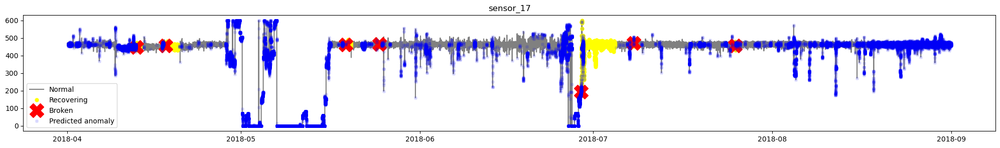

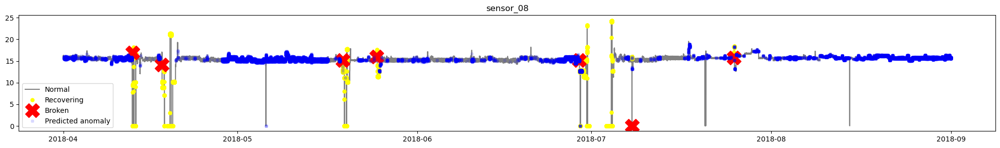

In [26]:
print('Bayesian Gaussian Mixture')
plot_sensor_anomalies('sensor_17', 'Bayesian Gaussian Mixture')
plot_sensor_anomalies('sensor_08', 'Bayesian Gaussian Mixture')

As seen numerically, the graphical representation shows many more anomalies than with the other algorithms.   
In conclusion, the Bayesian Gaussian Mixture with the parameters I defined found a lot of anomalies which are false positives.  
The optimal scenario would have been only finding anomalies near the breaking points of the pumps.

In all the algorithms the parameters need to be tuned to get better results.

### References
* Pump sensor data: https://www.kaggle.com/datasets/nphantawee/pump-sensor-data
* Scaling the data: https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.StandardScaler.html
* BayesianGaussianMixture : https://scikit-learn.org/stable/modules/generated/sklearn.mixture.BayesianGaussianMixture.html 
* BayesianGaussianMixture and anomaly detection algorithms: *GeÌ ron, A. (2019). Hands-on machine learning with Scikit-Learn, Keras and TensorFlow: concepts, tools, and techniques to build intelligent systems (2nd ed.). O'Reilly.*